# Useful snippets

Free OSM geocoder - place to coordinates (and zip code too!):

In [ ]:
import geocoder

g = geocoder.osm('University of Oxford, United Kingdom')
g.osm

{'x': -1.255807200927876,
 'y': 51.75805175000001,
 'addr:street': 'South Parks Road',
 'addr:city': 'Oxford',
 'addr:state': 'England',
 'addr:country': 'United Kingdom',
 'addr:postal': 'OX1 3TG'}

Function for converting coordinates in format x°y'z" E/W/N/S to decimal number to plot with matplotlib or plotly:

In [ ]:
def convert(old):
    direction = {'N':1, 'S':-1, 'E': 1, 'W':-1}
    if '°' not in old:
        old = '0°' + old
    new = old.replace('°',' ').replace('′',' ').replace('″',' ').replace('.',' ').replace('\'',' ').replace('"',' ')
    new = new.split()
    new_dir = new.pop()
    new.extend([0,0,0])
    return (int(new[0])+int(new[1])/60.0+int(new[2])/3600.0) * direction[new_dir[0]]

Getting coordinates of place by its name. There is a thing, that if osm can't find such place - it takes part of adress and tries to search again for more global object

In [ ]:
import geocoder

def get_coords(addr):
  result = geocoder.osm(addr)
  while not result:
    addr = ', '.join(addr.split(',')[1:])
    result = geocoder.osm(addr)

  # return lat, long
  return result.osm['y'], result.osm['x']

# Day 15. OpenStreetMap

In [ ]:
install.packages("osmdata")
install.packages("sf")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proj4’, ‘PROJ’, ‘crsmeta’, ‘Rcpp’, ‘reproj’


Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proxy’, ‘e1071’, ‘wk’, ‘classInt’, ‘s2’, ‘units’




In [ ]:
library(osmdata)
library(ggplot2)
library("sf")
library("dplyr")

In [ ]:
location <- getbb("Montaretto, Italy", featuretype = "city")
location['x', 'min'] <- 9.572246
location['x', 'max'] <- 9.580411
location['y', 'min'] <- 44.193128
location['y', 'max'] <- 44.199205
location

,min,max
x,9.572246,9.580411
y,44.193128,44.199205


Getting elements of landscape:

In [ ]:
streets <- location %>%
  opq() %>%
  add_osm_feature(key = "highway",
                  value = c("motorway", "trunk",  "primary",
                            "secondary", "tertiary")) %>%
  osmdata_sf()

In [ ]:
small_streets <- location %>%
  opq() %>%
  add_osm_feature(
    key = "highway",
    value = c("residential", "living", "unclassified",
              "service", "footway", "track")) %>%
  osmdata_sf()

In [ ]:
water <- location %>%
  opq() %>%
  add_osm_feature(key = "waterway", value = "river") %>%
  osmdata_sf()

In [ ]:
stairs <- location %>%
  opq() %>%
  add_osm_feature(key = "highway", value = "steps") %>%
  osmdata_sf()

In [ ]:
piazzas <- location %>%
  opq() %>%
  add_osm_feature(key = "highway", value = "pedestrian") %>%
  osmdata_sf()

In [ ]:
forest <- location %>%
  opq() %>%
  add_osm_feature(key = "landuse", value = "forest") %>%
  osmdata_sf()

In [ ]:
scrub <- location %>%
  opq() %>%
  add_osm_feature(key = "natural", value = "scrub") %>%
  osmdata_sf()

In [ ]:
sport <- location %>%
  opq() %>%
  add_osm_feature(key = "leisure", value = "pitch") %>%
  osmdata_sf()

In [ ]:
buildings <- location %>%
  opq() %>%
  add_osm_feature(key = "building") %>%
  osmdata_sf()

In [ ]:
location

,min,max
x,9.572246,9.580411
y,44.193128,44.199205


In [ ]:
xlimit <- c(9.572246, 9.580411)
ylimit <- c(44.193128,	44.199205)
xmid <- xlimit[1] + diff(xlimit) / 2
ratio <- diff(xlimit) / diff(ylimit)

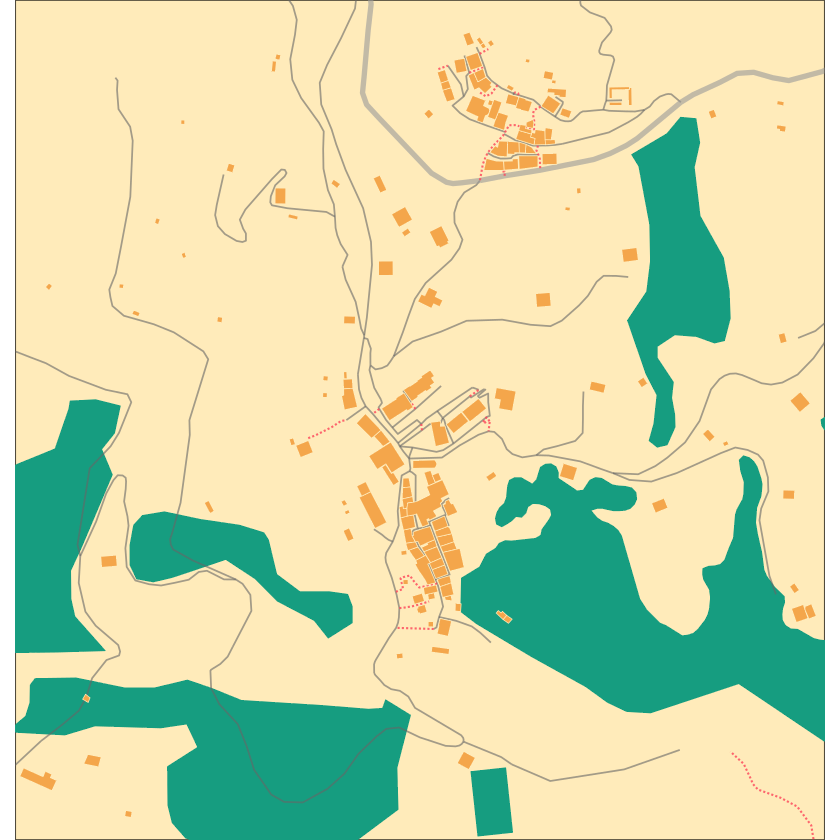

In [ ]:
map <- ggplot() +

  geom_sf(data = forest$osm_polygons, alpha = 1,
        size = .4, color = "#169D80", fill = "#169D80") +

  geom_sf(data = scrub$osm_polygons, alpha = 1,
        size = .4, color = "#169D80", fill = "#169D80") +

  geom_sf(data = sport$osm_polygons, alpha = 1,
        size = .4, color = "#169D80", fill = "#169D80") +

  # geom_sf(data = piazzas$osm_polygons, alpha = .8,
  #       color = "#ffefe5", fill = "#ffefe5") +

  # small streets
  geom_sf(data = small_streets$osm_lines, alpha = .6,
          size = .2, colour = "grey40") +
  # large steets, making them stand out a bit with colour
  geom_sf(data = streets$osm_lines, alpha = .6,
          linewidth = 1.5, colour = "grey60") +

  geom_sf(data = stairs$osm_lines, alpha = .8,
          colour = "#FC4459", linetype = "11", linewidth = 0.6) +

  geom_sf(data = buildings$osm_polygons, alpha = 1,
        size = .4, color = "#ffebba", fill = "#F4A64B") +

  # setting limits
  coord_sf(ylim = ylimit, xlim = xlimit, expand = FALSE) +
  theme_void() +
  theme(panel.background = element_rect(fill = "#ffebba"), #FCF3B6 #ffebcd #ffefd5 #ffebba
        plot.background = element_rect(fill = "#ffebba"))

map

In [ ]:
ggsave("montaretto.svg", device = 'svg', dpi = 370)

Saving 6.67 x 6.67 in image


# Day 16. Oceania

Dataset: www.aviationfile.com/aviation-data-download/

Bbox for Oceania:

In [ ]:
# -30.600094,-219.375000,13.239945,-130.078125

In [ ]:
!pip install -U kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 12.6 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.


In [ ]:
import numpy as np
import geopandas as gpd
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline

In [ ]:
aero = pd.read_csv('airports_of_OC.csv', index_col=0)
aero.head()

,type,name,latitude_deg,longitude_deg,elevation_ft,iso_country,gps_code,iata_code
0,small_airport,Utirik Airport,11.222000,169.852005,4.0,MH,K03N,UTK
1,small_airport,Atkamba Airport,-6.065556,141.095278,150.0,PG,NaN,ABP
2,small_airport,Andakombe Airport,-7.137222,145.744722,3600.0,PG,AYAN,ADC
3,small_airport,Aseki Airport,-7.350805,146.193867,4106.0,PG,AYAX,AEK
4,small_airport,Afore Airstrip,-9.142222,148.390833,2500.0,PG,AYAF,AFR


In [ ]:
aero.iso_country.unique()

array(['MH', 'PG', 'SB', 'AU', 'PW', 'NR', 'FJ', 'FM', 'NC', 'CK', 'TO',
       'KI', 'TV', 'NU', 'WF', 'AS', 'WS', 'PF', 'VU', 'NZ', 'MP', 'GU',
       'UM', 'NF'], dtype=object)

Let's drop Australia and New Zeland, because for this theme we need just Oceania

In [ ]:
aero = aero[~aero.iso_country.isin(['UM', 'AU', 'NZ'])]

In [ ]:
aero_geo = gpd.GeoDataFrame(aero,
    geometry = gpd.points_from_xy(aero['longitude_deg'], aero['latitude_deg']))

<ipython-input-7-dec8a82eddf0>:1: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


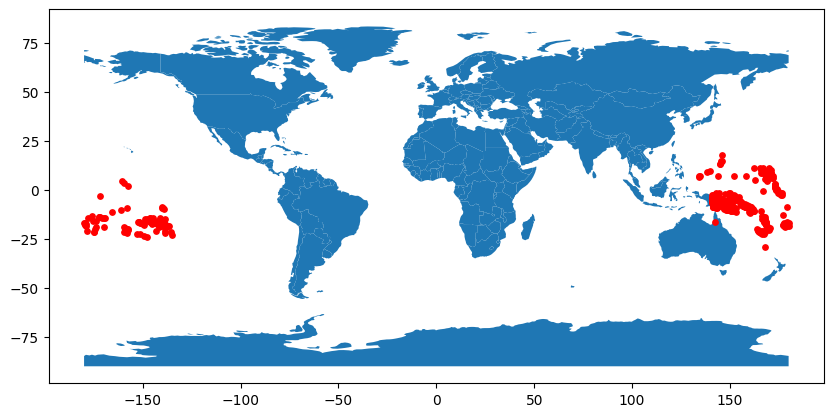

In [ ]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
aero_geo.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15);

In [ ]:
import plotly.express as px
import plotly.graph_objects as go
import pandas as pd

px.set_mapbox_access_token("my-token")

fig = px.scatter_mapbox(
    aero,
    lat="latitude_deg",
    lon="longitude_deg",
    hover_name="name",
    # color_discrete_sequence=["#fdae6b", "white", "#9ecbe2"],
    color_discrete_sequence=["white"],
    height=700,
    width=1400,
    color="type",
    zoom=3.2,
    center={'lat': -7, 'lon': 179},
)

fig.update_layout(mapbox_style="mapbox://styles/tabbt/clp1utv5e01cc01pmenhrcjjc")
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_traces(
        marker=dict(size=5)
    )

fig.show()

In [ ]:
import plotly.graph_objects as go

fig = go.Figure(data=go.Scattergeo(
        lon = aero['longitude_deg'],
        lat = aero['latitude_deg'],
        text = aero['name'],
        mode = 'markers',
        marker_color = '#ff8abd',
        ))

fig.update_layout(
        geo_scope='world',
        autosize=False,
        width=1600,
        height=800,
        margin={"t": 0, "b": 0, "l": 0, "b": 0},
        # yaxis_range=[0, 90],    # defines clip height
        # xaxis_range=[-75, 105], # defines clip width
    )
fig.show()

# Day 17. Flow

Data from https://search.earthdata.nasa.gov/search/granules?p=C2036880665-POCLOUD&pg[0][x]=2800518089!POCLOUD&pg[0][v]=f&pg[0][gsk]=-start_date&g=G2802639878-POCLOUD&tl=1700236133!3!!&fs10=ocean%20currents&fsm0=ocean%20circulation&fst0=oceans&lat=10.96875&long=-137.8125&zoom=0

In [ ]:
!pip install cartopy

<xarray.Dataset>
Dimensions:    (time: 1, year: 1, depth: 1, latitude: 481, longitude: 1201)
Coordinates:
  * time       (time) datetime64[ns] 2023-11-16
  * year       (year) float32 2.024e+03
  * depth      (depth) float32 15.0
  * latitude   (latitude) float64 80.0 79.67 79.33 79.0 ... -79.33 -79.67 -80.0
  * longitude  (longitude) float64 20.0 20.33 20.67 21.0 ... 419.3 419.7 420.0
Data variables:
    u          (time, depth, latitude, longitude) float64 ...
    v          (time, depth, latitude, longitude) float64 ...
    um         (time, depth, latitude, longitude) float64 ...
    vm         (time, depth, latitude, longitude) float64 ...
Attributes: (12/15)
    VARIABLE:       Ocean Surface Currents
    DATATYPE:       1/72 YEAR Interval
    DATASUBTYPE:    unfiltered
    GEORANGE:       20 to 420 -80 to 80
    PERIOD:         Nov.16,2023
    YEAR:           2023
    ...             ...
    SOURCE:         Gary Lagerloef, ESR (lager@esr.org) and Kathleen Dohan, E...
    CONTACT:

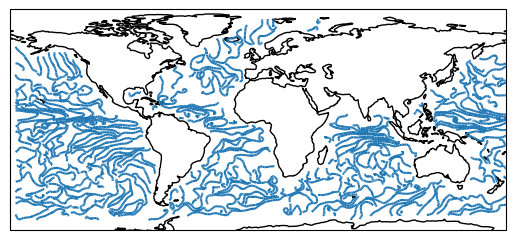

In [ ]:
import xarray as xr
import numpy as np
import cartopy.crs as ccrs
import matplotlib.pyplot as plt

with xr.open_dataset('oscar_vel11364.nc.gz') as ds:
    print(ds)

    ax = plt.axes(projection=ccrs.PlateCarree())

    dec = 10
    lon = ds.longitude.values[::dec]
    lon[lon>180] = lon[lon>180] - 360
    mymap=plt.streamplot(lon, ds.latitude.values[::dec], ds.u.values[0, 0, ::dec, ::dec], ds.v.values[0, 0, ::dec, ::dec], 6, transform=ccrs.PlateCarree(), arrowstyle='-')
    # ax.coastlines()
    plt.savefig("flows11364.svg")
    plt.show()

Then exported svg to Figma, tried to clean some unuseful parts of this crazy svg, then exported (~22k curves inside) and imported this in Blender

# Day 18. Atmosphere

Trying this dataset: https://www.kaggle.com/datasets/adityaramachandran27/world-air-quality-index-by-city-and-coordinates?select=AQI+and+Lat+Long+of+Countries.csv

In [ ]:
!pip install -U kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 12.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.


In [ ]:
import pandas as pd

df = pd.read_csv('AQI and Lat Long of Countries.csv')
df.head()

,Country,City,AQI Value,AQI Category,CO AQI Value,CO AQI Category,Ozone AQI Value,Ozone AQI Category,NO2 AQI Value,NO2 AQI Category,PM2.5 AQI Value,PM2.5 AQI Category,lat,lng
0,Russian Federation,Praskoveya,51,Moderate,1,Good,36,Good,0,Good,51,Moderate,44.7444,44.2031
1,Brazil,Presidente Dutra,41,Good,1,Good,5,Good,1,Good,41,Good,-5.2900,-44.4900
2,Brazil,Presidente Dutra,41,Good,1,Good,5,Good,1,Good,41,Good,-11.2958,-41.9869
3,Italy,Priolo Gargallo,66,Moderate,1,Good,39,Good,2,Good,66,Moderate,37.1667,15.1833
4,Poland,Przasnysz,34,Good,1,Good,34,Good,0,Good,20,Good,53.0167,20.8833


The World map:

In [ ]:
import plotly.figure_factory as ff
import plotly.express as px
import numpy as np

px.set_mapbox_access_token("my-token")

fig = ff.create_hexbin_mapbox(
    data_frame=df, lat="lat", lon="lng",
    nx_hexagon=150, opacity=0.8, labels={"color": "Average AQI"},
    center={'lat': 23.554688, 'lon': 10},
    zoom=1.3,
    # mapbox_style='open-street-map',
    # show_original_data=True,
    height=1000,
    width=1500,
    color="AQI Value", agg_func=np.mean, color_continuous_scale="Jet", range_color = [df["AQI Value"].min(), 250]
)
fig.write_image("heatmap.svg")
fig.show()

Europe:

In [ ]:
import plotly.figure_factory as ff
import plotly.express as px
import numpy as np

fig = ff.create_hexbin_mapbox(
    data_frame=df, lat="lat", lon="lng",
    nx_hexagon=150, opacity=0.8, labels={"color": "Average AQI"},
    center={'lat': 55, 'lon': 20},
    zoom=3,
    # mapbox_style='open-street-map',
    # show_original_data=True,
    height=1000,
    width=1000,
    color="AQI Value", agg_func=np.mean, color_continuous_scale="Jet", range_color = [df["AQI Value"].min(), 100]
)
fig.write_image("heatmap2.svg")
fig.show()

Americas:

In [ ]:
import plotly.figure_factory as ff
import plotly.express as px
import numpy as np

fig = ff.create_hexbin_mapbox(
    data_frame=df, lat="lat", lon="lng",
    nx_hexagon=150, opacity=0.8, labels={"color": "Average AQI"},
    center={'lat': 22, 'lon': -95},
    zoom=1.7,
    # mapbox_style='open-street-map',
    # show_original_data=True,
    height=900,
    width=850,
    color="AQI Value", agg_func=np.mean, color_continuous_scale="Jet", range_color = [df["AQI Value"].min(), 100]
)
fig.write_image("heatmap3.svg")
fig.show()

# Day 20. Outdoors

In [ ]:
install.packages("osmdata")
install.packages("sf")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proj4’, ‘PROJ’, ‘crsmeta’, ‘Rcpp’, ‘reproj’


Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proxy’, ‘e1071’, ‘wk’, ‘classInt’, ‘s2’, ‘units’




In [ ]:
library(osmdata)
library(ggplot2)
library("sf")
library("dplyr")

Data (c) OpenStreetMap contributors, ODbL 1.0. https://www.openstreetmap.org/copyright

Linking to GEOS 3.11.1, GDAL 3.6.4, PROJ 9.1.1; sf_use_s2() is TRUE


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [ ]:
location <- getbb("Schladming, Austria", featuretype = "city")
location['x', 'min'] <- 13.629
location['x', 'max'] <- 13.734
location['y', 'min'] <- 47.357
location['y', 'max'] <- 47.41
location

,min,max
x,13.629,13.734
y,47.357,47.410


Getting elements of landscape:

In [ ]:
streets <- location %>%
  opq() %>%
  add_osm_feature(key = "highway",
                  value = c("motorway", "trunk",  "primary",
                            "secondary", "tertiary")) %>%
  osmdata_sf()

In [ ]:
small_streets <- location %>%
  opq() %>%
  add_osm_feature(
    key = "highway",
    value = c("residential", "living", "unclassified",
              "service", "footway")) %>%
  osmdata_sf()

In [ ]:
river <- location %>%
  opq() %>%
  add_osm_feature(key = "waterway", value = "river") %>%
  osmdata_sf()

In [ ]:
lake <- location %>%
  opq() %>%
  add_osm_feature(key = "natural", value = "water") %>%
  osmdata_sf()

In [ ]:
stream <- location %>%
  opq() %>%
  add_osm_feature(key = "waterway", value = "stream") %>%
  osmdata_sf()

In [ ]:
cycle <- location %>%
  opq() %>%
  add_osm_feature(key = "highway", value = "cycleway") %>%
  osmdata_sf()

In [ ]:
forest <- location %>%
  opq() %>%
  add_osm_feature(key = "landuse", value = "forest") %>%
  osmdata_sf()

In [ ]:
meadow <- location %>%
  opq() %>%
  add_osm_feature(key = "landuse", value = "meadow") %>%
  osmdata_sf()

In [ ]:
pedestrian <- location %>%
  opq() %>%
  add_osm_feature(key = "highway", value = c("path", "track")) %>%
  osmdata_sf()

In [ ]:
buildings <- location %>%
  opq() %>%
  add_osm_feature(key = "building") %>%
  osmdata_sf()

In [ ]:
location_ski <- getbb("Schladming, Austria", featuretype = "city")
location_ski['x', 'min'] <- 13.633
location_ski['x', 'max'] <- 13.73
location_ski['y', 'min'] <- 47.357
location_ski['y', 'max'] <- 47.395

In [ ]:
gondola <- location_ski %>%
  opq() %>%
  add_osm_feature(key = "aerialway", value = "gondola") %>%
  osmdata_sf()

In [ ]:
chairway <- location_ski %>%
  opq() %>%
  add_osm_feature(key = "aerialway", value = "chair_lift") %>%
  osmdata_sf()

In [ ]:
ski1 <- location_ski %>%
  opq() %>%
  add_osm_feature(key = "piste:difficulty", value = "easy") %>%
  osmdata_sf()

ski2 <- location_ski %>%
  opq() %>%
  add_osm_feature(key = "piste:difficulty", value = "intermediate") %>%
  add_osm_feature(key = "name", value = "!Mitterhausabfahrt") %>%
  osmdata_sf()

ski3 <- location_ski %>%
  opq() %>%
  add_osm_feature(key = "piste:difficulty", value = c("advanced", "expert, extreme", "freeride")) %>%
  osmdata_sf()

In [ ]:
xlimit <- c(location['x', 'min'], location['x', 'max'])
ylimit <- c(location['y', 'min'], location['y', 'max'])
xmid <- xlimit[1] + diff(xlimit) / 2
ratio <- diff(xlimit) / diff(ylimit)

In [ ]:
c_bg <- "#f8f9fa"
c_forest <- "#ced4da"
c_meadow <- "#dee2e6"
c_river <- "#457b9d"
c_water <- "#457b9d"
c_chairs <- "#fc814a"
c_gondola <- "#fc814a"
c_sm_streets <- "grey70"
c_streets <- "grey75"
c_ski1 <- "#0086eb"
c_ski2 <- "#ff4000"
c_ski3 <- "gray20"
c_path <- "#f8f9fa"

# c_bg <- "beige"
# c_forest <- "#90be6d"
# c_meadow <- "#c9e3ac"
# c_river <- "#5290BD"
# c_water <- "#7DD9E4"
# c_chairs <- "#ea9010"
# c_gondola <- "#ea9010"
# c_sm_streets <- "grey70"
# c_streets <- "grey70"
# c_ski1 <- "#457b9d"
# c_ski2 <- "#e63946"
# c_ski3 <- "#1d3557"
# c_path <- "#ffefe5"

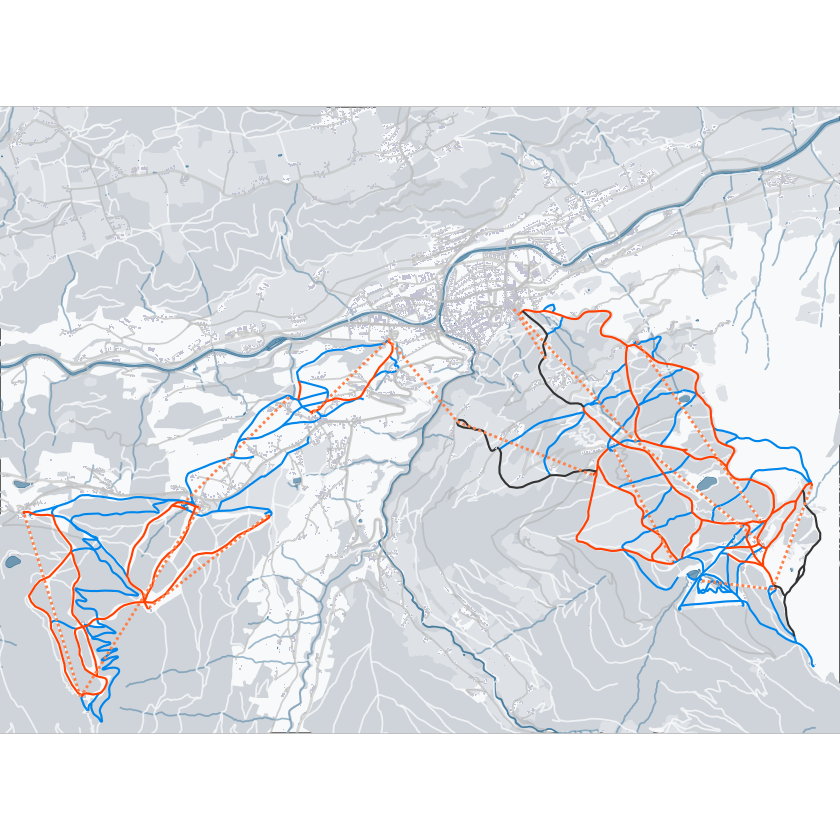

In [ ]:
map <- ggplot() +

  geom_sf(data = forest$osm_polygons, alpha = 1,
        size = .4, color = c_forest, fill = c_forest) +

  geom_sf(data = meadow$osm_polygons, alpha = 1,
        size = .4, color = c_meadow, fill = c_meadow) +

  geom_sf(data = river$osm_lines, alpha = 0.3,
          linewidth = 1.8, colour = c_river) +

  geom_sf(data = stream$osm_lines, alpha = 0.5,
          linewidth = 0.5, colour = c_water) +

  geom_sf(data = lake$osm_polygons, alpha = 0.7,
        size = .4, color = c_water, fill = c_water) +

  geom_sf(data = pedestrian$osm_lines, alpha = .8,
        colour = c_path) +

  geom_sf(data = cycle$osm_lines, alpha = .8,
        colour = c_path) +

  geom_sf(data = small_streets$osm_lines, alpha = .6,
          size = .2, colour = c_sm_streets) +

  geom_sf(data = streets$osm_lines, alpha = .6,
          linewidth = 0.8, colour = c_streets) +

  geom_sf(data = ski1$osm_lines, alpha = 1,
          linewidth = 0.6, colour = c_ski1) +

  geom_sf(data = ski2$osm_lines, alpha = 1,
          linewidth = 0.6, colour = c_ski2) +

  geom_sf(data = ski3$osm_lines, alpha = 1,
          linewidth = 0.6, colour = c_ski3) +

  # geom_sf(data = buildings$osm_polygons, alpha = 0.7,
  #       size = .03, color = c_bg, fill = "#F4A64B") +

  geom_sf(data = buildings$osm_polygons, alpha = 1,
      size = .03, color = "#80808000", fill = "#c1c3d4") +

  geom_sf(data = chairway$osm_lines, alpha = 1,
        linewidth = 0.8, color = c_chairs, fill = c_chairs, linetype = "11") +

  geom_sf(data = gondola$osm_lines, alpha = 1,
        linewidth = 0.8, color = c_gondola, fill = c_gondola, linetype = "11") +

  # setting limits
  coord_sf(ylim = ylimit, xlim = xlimit, expand = FALSE) +
  theme_void() +
  theme(panel.background = element_rect(fill = c_bg),
        plot.background = element_rect(fill = c_bg))

map

In [ ]:
ggsave("schladming.png", device = 'png', dpi = 500)

Saving 6.67 x 6.67 in image


# Day 23. 3D

In [ ]:
install.packages("devtools")
devtools::install_github("tylermorganwall/rayshader")

In [ ]:
install.packages("ambient")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)



DEM data was cut in QGIS from larger cell from https://ec.europa.eu/eurostat/web/gisco/geodata/reference-data/elevation/copernicus-dem/elevation

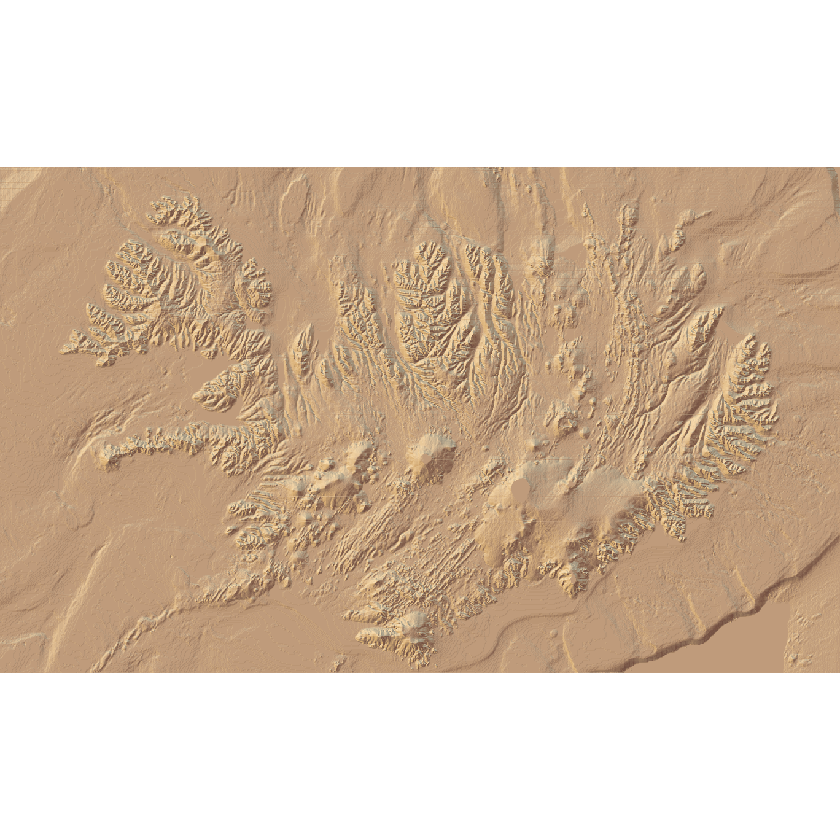

In [ ]:
library(rayshader)

#Here, I load a map with the raster package.
# loadzip = tempfile()
# download.file("https://tylermw.com/data/dem_01.tif.zip", loadzip)
# localtif = raster::raster(unzip(loadzip, "dem_01.tif"))
# unlink(loadzip)
localtif = raster::raster("iceland-2.tif")

#And convert it to a matrix:
elmat = raster_to_matrix(localtif)

#We use another one of rayshader's built-in textures:
elmat %>%
  sphere_shade(texture = "desert") %>%
  plot_map()

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  # add_water(detect_water(elmat), color = "desert") %>%
  add_shadow(ray_shade(elmat, zscale = 3), 0.5) %>%
  add_shadow(ambient_shade(elmat), 0) %>%
  plot_3d(elmat, zscale = 7, fov = 0, theta = 45, zoom = 0.45, phi = 30, windowsize = c(1000, 800),
          water = TRUE, waterdepth = 89, wateralpha = 0.5, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
Sys.sleep(0.2)
render_snapshot()

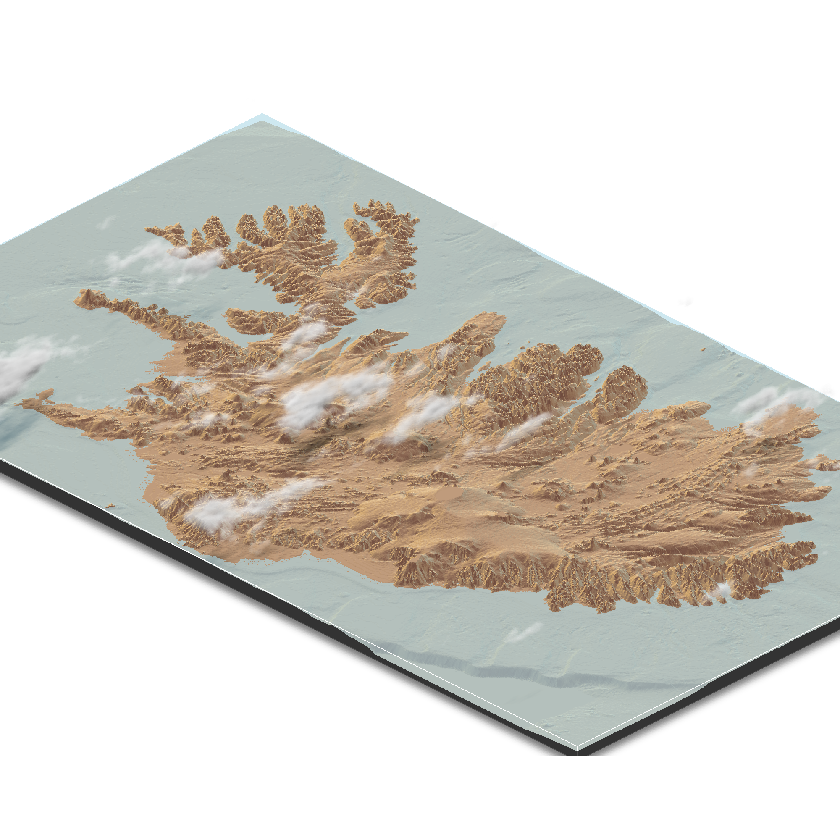

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  # add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat,zscale = 10, start_altitude = 500, end_altitude = 700,
                         sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.3, frequency = 0.01, scale_y=3, fractal_levels = 32), 0) %>%
  plot_3d(elmat, zscale = 7, fov = 0, theta = 45, zoom = 0.45, phi = 30, windowsize = c(2000, 1600),
          water = TRUE, waterdepth = 89, wateralpha = 0.6, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
# render_camera(theta = 125, phi=22,zoom= 0.47, fov= 60 )

render_clouds(elmat, zscale = 10, start_altitude = 500, end_altitude = 700,
              sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.3, frequency = 0.01, scale_y=3, fractal_levels = 32, clear_clouds = T)
render_snapshot(clear=TRUE)

Rendering to file:

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  # add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat,zscale = 10, start_altitude = 500, end_altitude = 700,
                         sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.33, frequency = 0.01, scale_y=3, fractal_levels = 32), 0) %>%
  plot_3d(elmat, zscale = 7, fov = 0, theta = 45, zoom = 0.45, phi = 30, windowsize = c(2000, 1600),
          water = TRUE, waterdepth = 89, wateralpha = 0.6, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
# render_camera(theta = 125, phi=22,zoom= 0.47, fov= 60 )

render_clouds(elmat, zscale = 10, start_altitude = 500, end_altitude = 700,
              sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.33, frequency = 0.01, scale_y=3, fractal_levels = 32, clear_clouds = T)

render_snapshot("iceland.png", clear = TRUE)

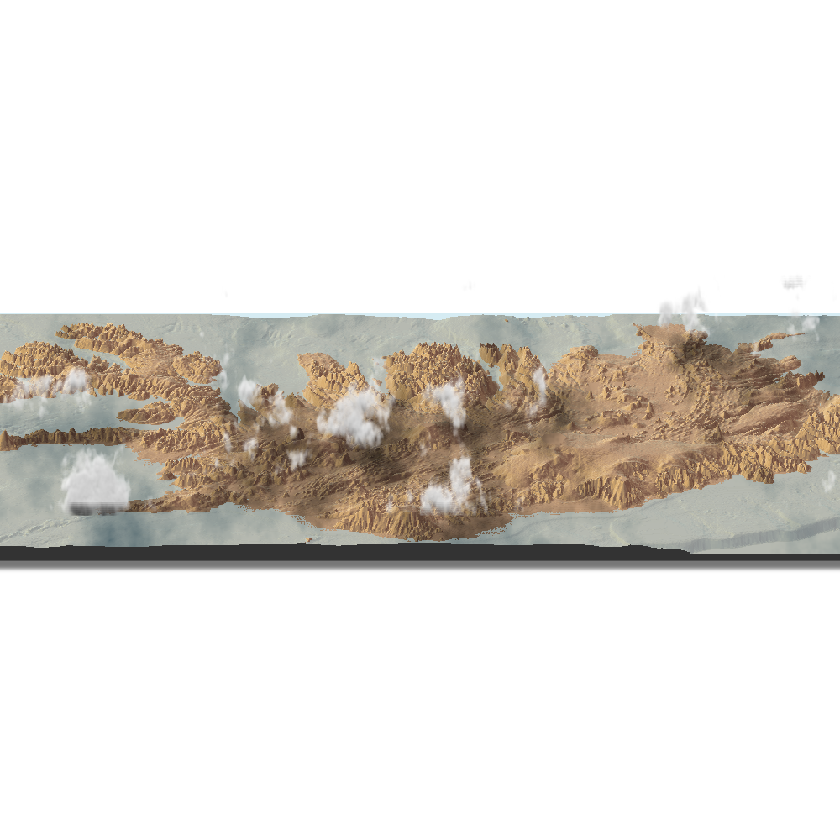

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  # add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat,zscale = 10, start_altitude = 500, end_altitude = 700,
                         sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.55, frequency = 0.01, scale_y=3, fractal_levels = 32), 0) %>%
  plot_3d(elmat, zscale = 6, fov = 0, theta = 0, zoom = 0.45, phi = 20, windowsize = c(1000, 800),
          water = TRUE, waterdepth = 89, wateralpha = 0.5, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
# render_camera(theta = 125, phi=22,zoom= 0.47, fov= 60 )

render_clouds(elmat, zscale = 10, start_altitude = 500, end_altitude = 700,
              sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.3, frequency = 0.01, scale_y=3, fractal_levels = 32, clear_clouds = T)
render_snapshot(clear=TRUE)

## Examples from library tutorials

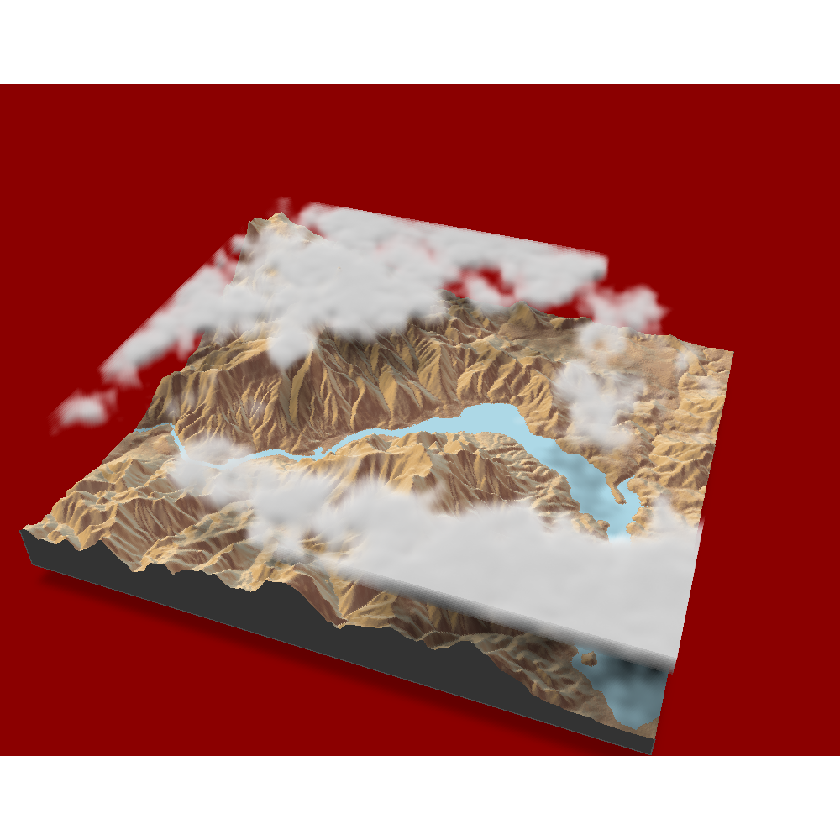

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat, zscale = 10, start_altitude = 500, end_altitude = 1000,), 0) %>%
  plot_3d(elmat, zscale = 10, fov = 0, theta = 135, zoom = 0.75, phi = 45, windowsize = c(1000, 800),
          background="darkred")
render_camera(theta = 20, phi=40,zoom= 0.64, fov= 56 )

render_clouds(elmat, zscale = 10, start_altitude = 800, end_altitude = 1000, attenuation_coef = 2, clear_clouds = T)
render_snapshot(clear=TRUE)

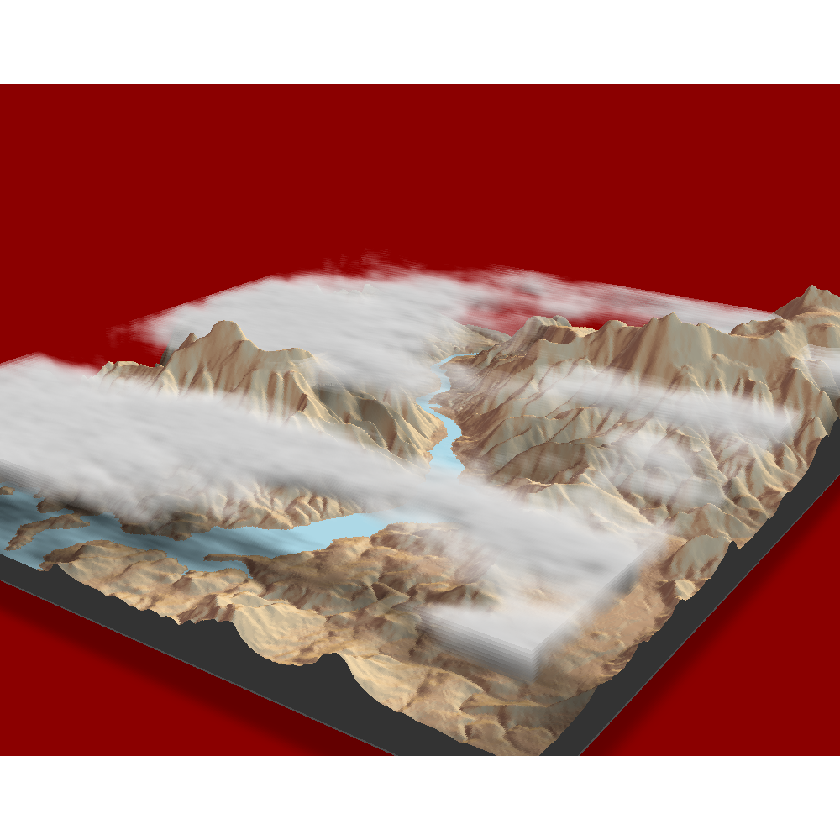

In [ ]:
elmat %>%
  sphere_shade(texture = "desert") %>%
  add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat,zscale = 10, start_altitude = 500, end_altitude = 700,
                         sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.55, frequency = 0.01, scale_y=3, fractal_levels = 32), 0) %>%
  plot_3d(elmat, zscale = 10, fov = 0, theta = 135, zoom = 0.75, phi = 45, windowsize = c(1000, 800),
          background="darkred")
render_camera(theta = 125, phi=22,zoom= 0.47, fov= 60 )

render_clouds(elmat, zscale = 10, start_altitude = 500, end_altitude = 700,
              sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.55, frequency = 0.01, scale_y=3, fractal_levels = 32, clear_clouds = T)
render_snapshot(clear=TRUE)

## Tried Yosemite but don't like it

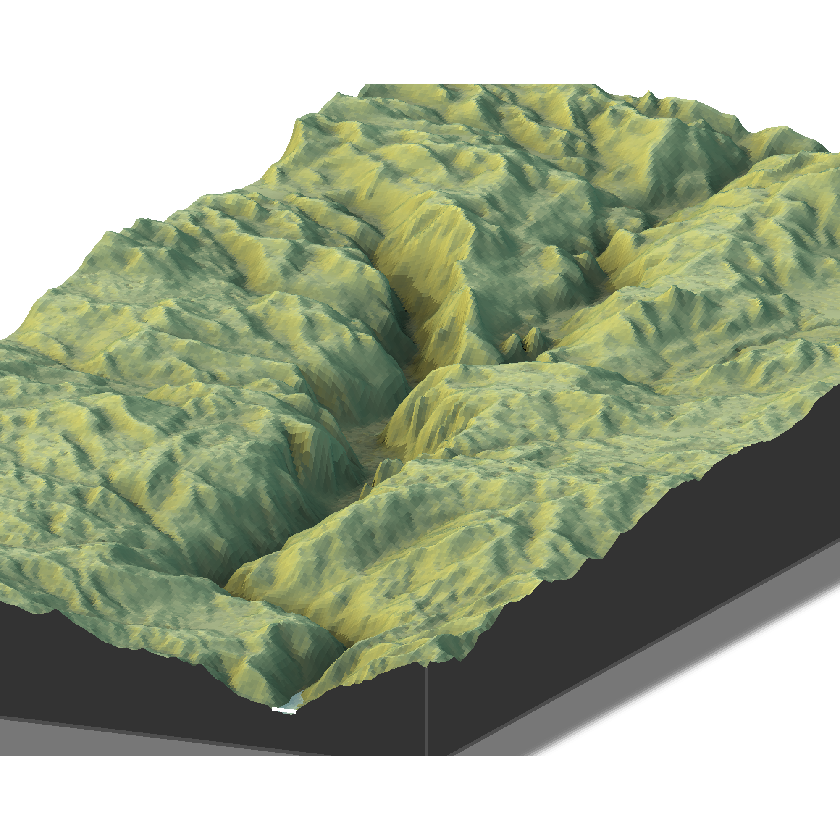

In [ ]:
elmat %>%
  sphere_shade(texture = "imhof1") %>%
  add_water(detect_water(elmat), color = "desert") %>%
  add_shadow(ray_shade(elmat, zscale = 3), 0.5) %>%
  add_shadow(ambient_shade(elmat), 0) %>%
  plot_3d(elmat, zscale = 5, fov = 0, theta = -65, zoom = 0.3, phi = 15, windowsize = c(2000, 1600),
          water = TRUE, waterdepth = 5, wateralpha = 0.5, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
Sys.sleep(0.2)
render_snapshot()

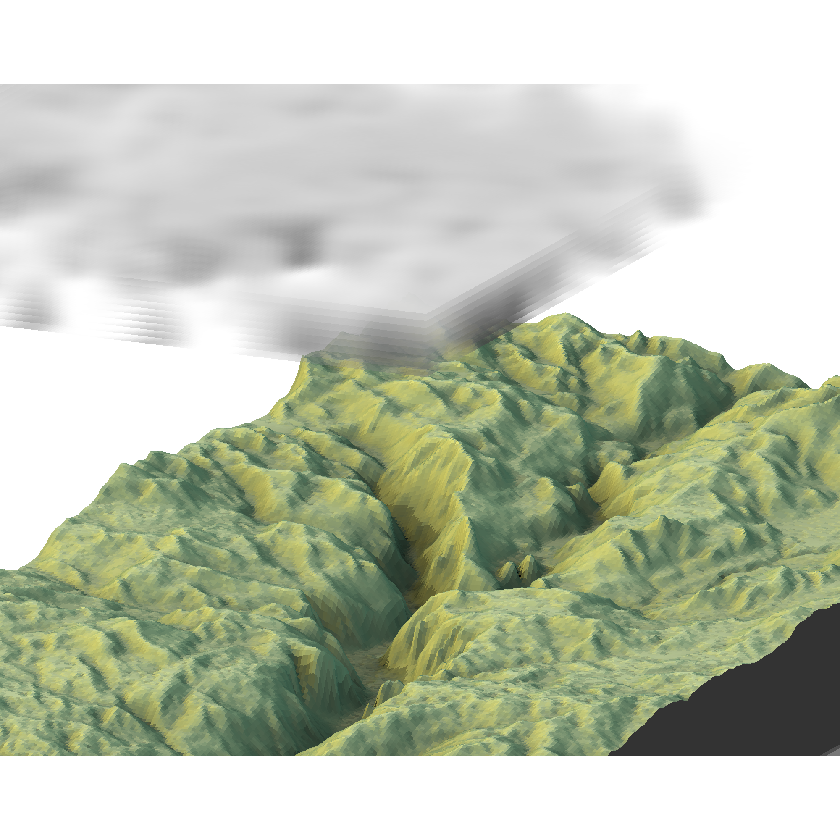

In [ ]:
elmat %>%
  sphere_shade(texture = "imhof1") %>%
  add_water(detect_water(elmat), color = "desert") %>%
  add_shadow(ray_shade(elmat, zscale = 3), 0.5) %>%
  add_shadow(ambient_shade(elmat), 0) %>%
  plot_3d(elmat, zscale = 5, fov = 0, theta = -65, zoom = 0.3, phi = 15, windowsize = c(2000, 1600),
          water = TRUE, waterdepth = 10, wateralpha = 0.5, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
render_clouds(elmat, zscale = 10, start_altitude = 1600, end_altitude = 1800, attenuation_coef = 2, clear_clouds = T)
render_snapshot(clear=TRUE)

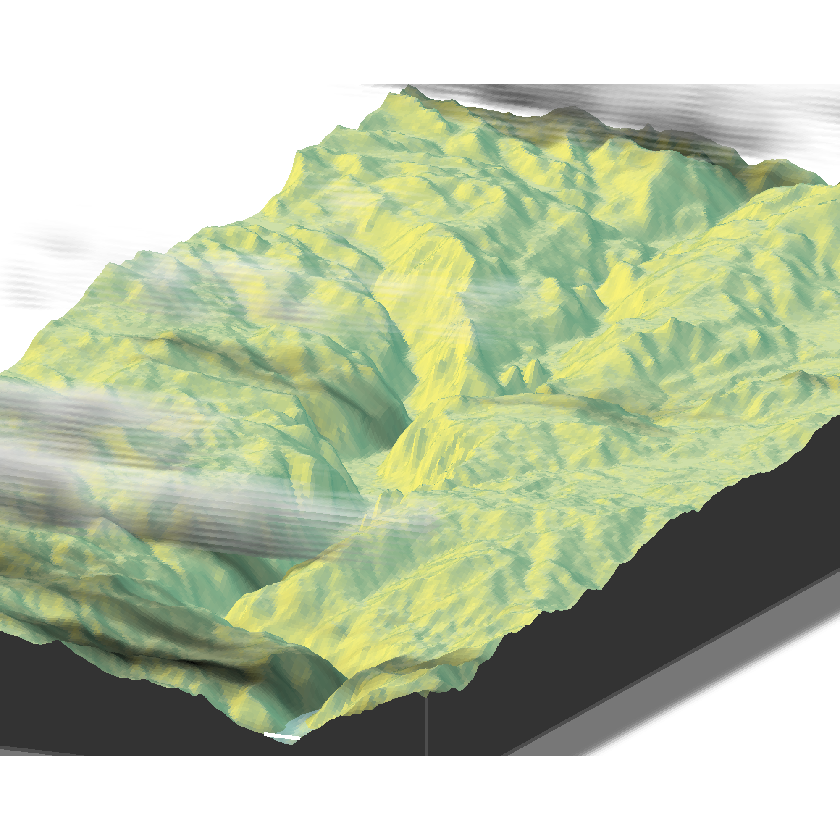

In [ ]:
elmat %>%
  sphere_shade(texture = "imhof1") %>%
  # add_water(detect_water(elmat), color = "lightblue") %>%
  add_shadow(cloud_shade(elmat,zscale = 10, start_altitude = 500, end_altitude = 700,
                         sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.3, frequency = 0.01, scale_y=3, fractal_levels = 32), 0) %>%
  plot_3d(elmat, zscale = 5, fov = 0, theta = -65, zoom = 0.3, phi = 15, windowsize = c(2000, 1600),
          water = TRUE, waterdepth = 10, wateralpha = 0.5, watercolor = "lightblue",
          waterlinecolor = "white", waterlinealpha = 0.5)
# render_camera(theta = 125, phi=22,zoom= 0.47, fov= 60 )

render_clouds(elmat, zscale = 10, start_altitude = 500, end_altitude = 700,
              sun_altitude = 45, attenuation_coef = 2, offset_y = 300,
              cloud_cover = 0.3, frequency = 0.01, scale_y=3, fractal_levels = 32, clear_clouds = T)
render_snapshot(clear=TRUE)

# Day 24. Black & White

In [ ]:
!pip install osmnx

In [ ]:
import osmnx as ox
import matplotlib.pyplot as plt
%matplotlib inline

# Specify the name that is used to seach for the data
# place_name_example = 'Tsentralny District, Sankt Petersburg, Russia'
place_name_example = 'Venice, Italy'

# Fetch OSM street network from the location
# graph = ox.graph_from_place(place_name_example)
graph = ox.graph_from_bbox(45.450136, 45.422070, 12.367172, 12.300053)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


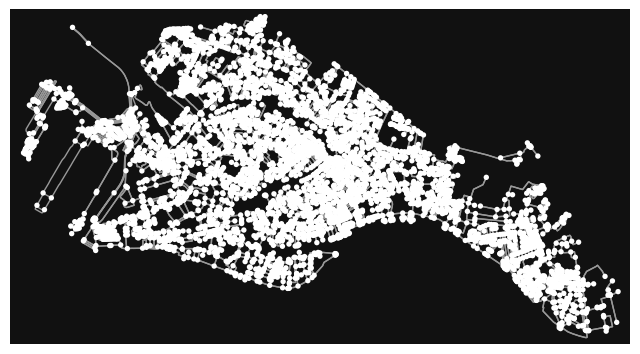

In [ ]:
fig, ax = ox.plot_graph(graph)

In [ ]:
area = ox.geocode_to_gdf(place_name_example)
buildings = ox.features_from_place(place_name_example, {'building': True})
restaurants = ox.features_from_place(place_name_example, {'amenity': ['restaurant']})
nodes, edges = ox.graph_to_gdfs(graph)

In [ ]:
area = ox.geocode_to_gdf('Venezia island')
buildings = ox.features_from_bbox(45.450136, 45.422070, 12.367172, 12.300053, {'building': True})
restaurants = ox.features_from_bbox(45.450136, 45.422070, 12.367172, 12.300053, {'amenity': ['restaurant']})
nodes, edges = ox.graph_to_gdfs(graph)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
from pyproj import CRS

# Set projection
projection = CRS.from_epsg(3067)

# Re-project layers
area = area.to_crs(projection)
edges = edges.to_crs(projection)
buildings = buildings.to_crs(projection)
restaurants = restaurants.to_crs(projection)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


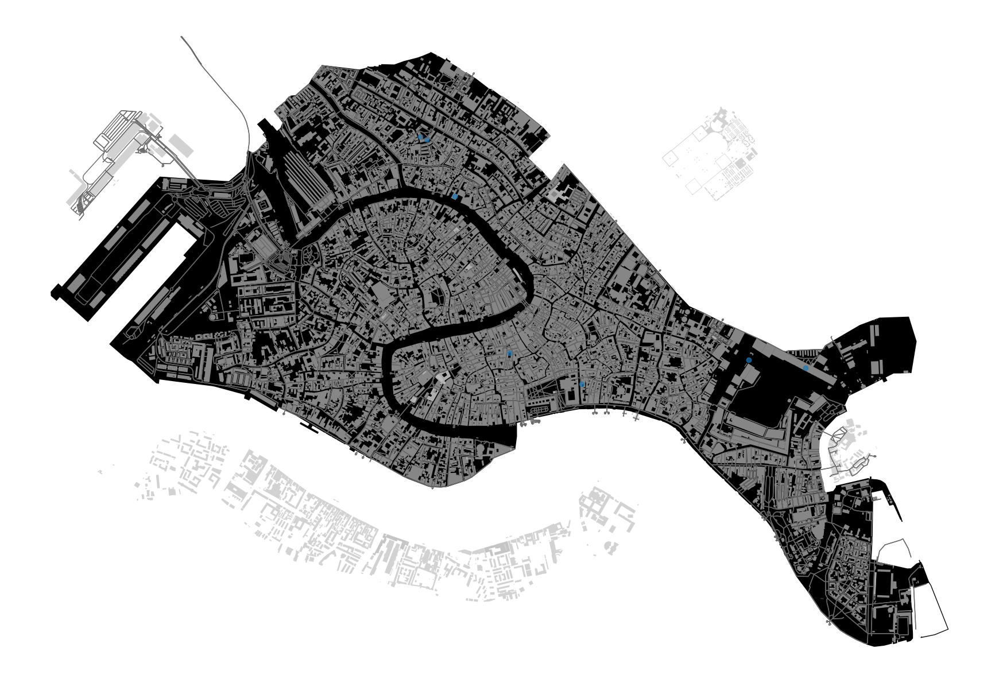

In [ ]:
fig, ax = plt.subplots(figsize=(18,12))

# Plot the footprint
area.plot(ax=ax, facecolor='black')

# Plot street edges
edges.plot(ax=ax, linewidth=1, edgecolor='dimgray')

# Plot buildings
buildings.plot(ax=ax, facecolor='silver', alpha=0.7)

# Plot restaurants
# restaurants.plot(ax=ax, color='yellow', alpha=0.7, markersize=10)
plt.axis('off')
plt.tight_layout()
plt.savefig("Venice.png", dpi=370)
plt.show()

In [ ]:
place_name = 'Tsentralny District, Sankt Petersburg, Russia'

# area = ox.geocode_to_gdf(place_name)
buildings = ox.features_from_place(place_name, {'building': True})
# restaurants = ox.features_from_place(place_name, {'amenity': ['restaurant']})
# nodes, edges = ox.graph_to_gdfs(graph)

In [ ]:
from pyproj import CRS

# Set projection
projection = CRS.from_epsg(3067)

buildings = buildings.to_crs(projection)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


In [ ]:
fig, ax = plt.subplots(figsize=(12,8))

buildings.plot(ax=ax, facecolor='black', alpha=1)

plt.axis('off')
plt.tight_layout()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)
<ipython-input-15-77b75b6c5e58>:3: UserWarning: The `geometries` module and `geometries_from_X` functions have been renamed the `features` module and `features_from_X` functions. Use these instead. The `geometries` module and function names are deprecated and will be removed in a future release.
  gdf = ox.geometries_from_place(place_name, tags={'building':True})


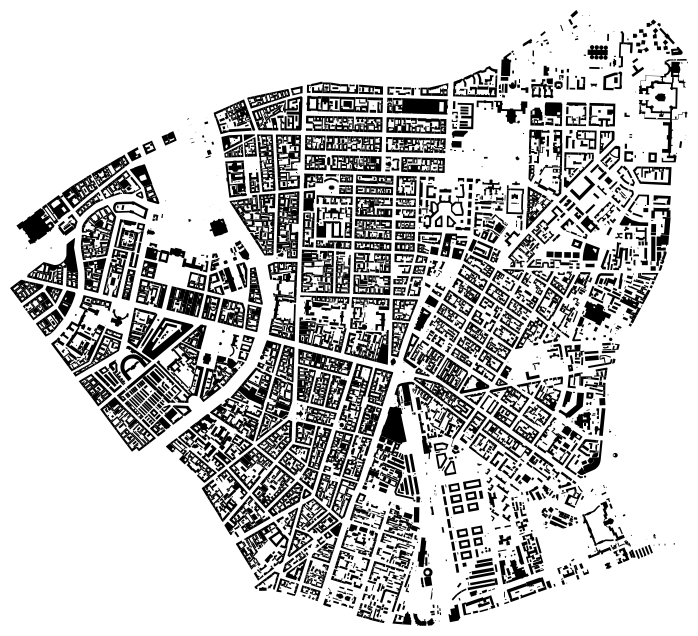

In [ ]:
import osmnx as ox

gdf = ox.geometries_from_place(place_name, tags={'building':True})
fig, ax = ox.plot_footprints(gdf, figsize=(12,8), color='black', bgcolor='white')

# Day 25. Antarctica

Data source: https://coolantarctica.com/Community/antarctic_bases.php

DEM source: BEDMAP2

In [ ]:
import pandas as pd


df = pd.read_excel("arctic_stations.xlsx")
df.head()

,Station Name,Nation,Coordinates,Situation,Altitude,Airfield,Opened,Average Winter,Peak Summer
0,Aboa,Finland,"73°03'S, 013°25'W",Queen Maud Land,400 m,NaN,1989.0,NaN,20.0
1,Amundsen-Scott,USA,"89°59.85'S, 139°16.37'E",South Pole,2 830 m,ski,1956.0,75.0,250.0
2,Arctowski,NaN,"62°09.57'S, 058°28.25'W",King George Island - Peninsula,2 m,NaN,1977.0,12.0,40.0
3,Artigas,Uruguay,"62°11.07'S, 058°54.15'W",King George Island - Peninsula,17 m,NaN,1984.0,9.0,60.0
4,Arturo Parodi,Chile,"80°19.10'S, 081°18.48'W",Patriot Hills,880 m,wheel & ski,NaN,NaN,NaN


In [ ]:
df['Coordinates'] = df['Coordinates'].apply(lambda x: x.split('/')[0] if '/' in x else x)
df[['Latitude', 'Longitude']] = df['Coordinates'].str.split(' ', n=1, expand=True)

df = df[df['Latitude'].str.contains('S|N')]
df = df[df['Longitude'].str.contains('E|W')]

df['Latitude']  = df['Latitude'].apply(convert)
df['Longitude']  = df['Longitude'].apply(convert)
df.head()

,Station Name,Nation,Coordinates,Situation,Altitude,Airfield,Opened,Average Winter,Peak Summer,Latitude,Longitude
0,Aboa,Finland,"73°03'S, 013°25'W",Queen Maud Land,400 m,NaN,1989.0,NaN,20.0,-73.050000,-13.416667
1,Amundsen-Scott,USA,"89°59.85'S, 139°16.37'E",South Pole,2 830 m,ski,1956.0,75.0,250.0,-90.006944,139.276944
2,Arctowski,NaN,"62°09.57'S, 058°28.25'W",King George Island - Peninsula,2 m,NaN,1977.0,12.0,40.0,-62.165833,-58.473611
3,Artigas,Uruguay,"62°11.07'S, 058°54.15'W",King George Island - Peninsula,17 m,NaN,1984.0,9.0,60.0,-62.185278,-58.904167
4,Arturo Parodi,Chile,"80°19.10'S, 081°18.48'W",Patriot Hills,880 m,wheel & ski,NaN,NaN,NaN,-80.319444,-81.313333


<ipython-input-5-4d2e698e1297>:10: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


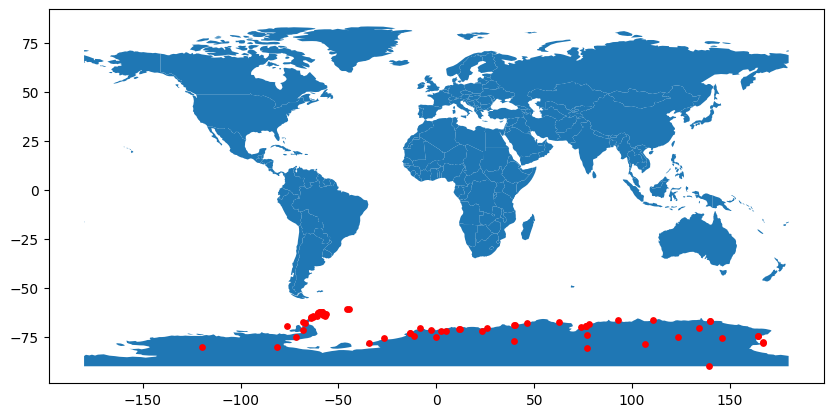

In [ ]:
import pandas as pd
from shapely.geometry import Point
import geopandas as gpd
from geopandas import GeoDataFrame

geometry = [Point(xy) for xy in zip(df['Longitude'], df['Latitude'])]
gdf = GeoDataFrame(df, geometry=geometry)

#this is a simple map that goes with geopandas
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))
gdf.plot(ax=world.plot(figsize=(10, 6)), marker='o', color='red', markersize=15);

In [ ]:
gdf.crs = 4326

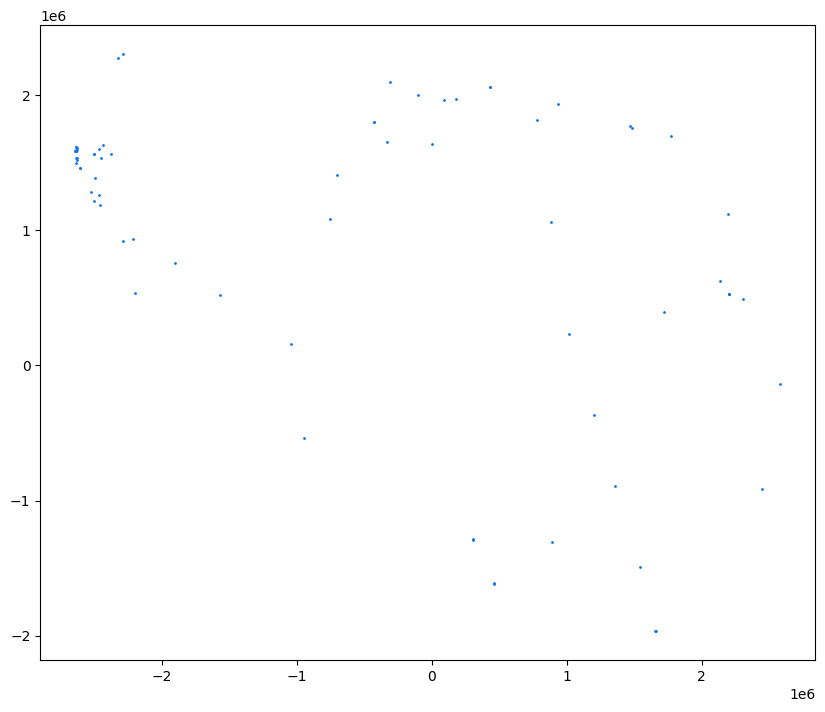

In [ ]:
import matplotlib.pyplot as plt

df_wm = gdf.to_crs(epsg=3031)
df_wm.plot(figsize=(10, 10), alpha=1, edgecolor="#1174E9", markersize=1)

plt.savefig("antarctica.svg")
plt.show()

After that, exported to Figma, removed background and added to 3D model in Blender

# Day 26. Minimal

In [ ]:
install.packages("osmdata")
install.packages("sf")

Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proj4’, ‘PROJ’, ‘crsmeta’, ‘Rcpp’, ‘reproj’


Installing package into ‘/usr/local/lib/R/site-library’
(as ‘lib’ is unspecified)

also installing the dependencies ‘proxy’, ‘e1071’, ‘wk’, ‘classInt’, ‘s2’, ‘units’




In [ ]:
library(osmdata)
library(ggplot2)
library("sf")
library("dplyr")

Data (c) OpenStreetMap contributors, ODbL 1.0. https://www.openstreetmap.org/copyright

Linking to GEOS 3.10.2, GDAL 3.4.3, PROJ 8.2.1; sf_use_s2() is TRUE


Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




In [ ]:
location <- getbb("МГТУ им. Н.Э. Баумана, Москва", featuretype = "city")
# 37.677011,55.763972,37.703147,55.776452
location['x', 'min'] <- 37.677011
location['x', 'max'] <- 37.703147
location['y', 'min'] <- 55.763972
location['y', 'max'] <- 55.776452
location

,min,max
x,37.67701,37.70315
y,55.76397,55.77645


Getting elements of landscape:

In [ ]:
streets <- location %>%
  opq() %>%
  add_osm_feature(key = "highway",
                  value = c("motorway", "trunk",  "primary", "residential", "unclassified",
                            "secondary", "tertiary")) %>%
  osmdata_sf()

In [ ]:
location

,min,max
x,37.67701,37.70315
y,55.76397,55.77645


In [ ]:
xlimit <- c(37.67701, 37.70315)
ylimit <- c(55.76397, 55.77645)
xmid <- xlimit[1] + diff(xlimit) / 2
ratio <- diff(xlimit) / diff(ylimit)

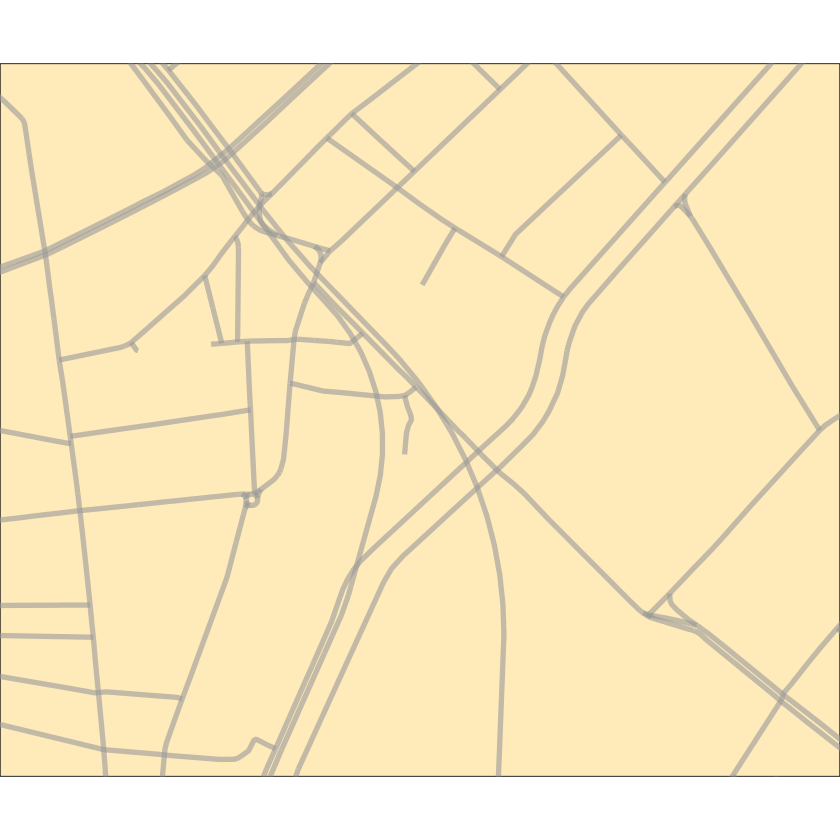

In [ ]:
map <- ggplot() +

  # geom_sf(data = piazzas$osm_polygons, alpha = .8,
  #       color = "#ffefe5", fill = "#ffefe5") +

  # small streets
  # geom_sf(data = small_streets$osm_lines, alpha = .6,
  #         size = .2, colour = "grey40") +
  # large steets, making them stand out a bit with colour
  geom_sf(data = streets$osm_lines, alpha = .6,
          linewidth = 1.5, colour = "grey60") +

  # geom_sf(data = buildings$osm_polygons, alpha = 1,
  #       size = .4, color = "#ffebba", fill = "#F4A64B") +

  # setting limits
  coord_sf(ylim = ylimit, xlim = xlimit, expand = FALSE) +
  theme_void() +
  theme(panel.background = element_rect(fill = "#ffebba"), #FCF3B6 #ffebcd #ffefd5 #ffebba
        plot.background = element_rect(fill = "#ffebba"))

map

In [ ]:
ggsave("bmstu.svg", device = 'svg')

Saving 6.67 x 6.67 in image


Then postprocessing in Figma

# Day 27. Dot

In [ ]:
!pip install osmnx

Tried to clip areas by bbox, but unsuccessfully and was short of time :(

In [ ]:
import osmnx as ox
import matplotlib.pyplot as plt
%matplotlib inline

# 28.964596,41.021096,28.997641,41.041426

area1 = ox.geocode_to_gdf('Beyoğlu, Istanbul')
area2 = ox.geocode_to_gdf('Şişli, Istanbul')
area3 = ox.geocode_to_gdf('Beşiktaş, Istanbul')

# area1['geometry'] = area1['geometry'].clip([41.021096, 41.041426, 28.964596, 28.997641])
# area2['geometry'] = area2['geometry'].clip([41.021096, 41.041426, 28.964596, 28.997641])
# area3['geometry'] = area3['geometry'].clip([41.021096, 41.041426, 28.964596, 28.997641])

buildings = ox.features_from_bbox(41.021096, 41.041426, 28.964596, 28.997641, {'building': True})
restaurants = ox.features_from_bbox(41.021096, 41.041426, 28.964596, 28.997641, {'amenity': ['cafe']})
graph = ox.graph_from_bbox(41.021096, 41.041426, 28.964596, 28.997641)
nodes, edges = ox.graph_to_gdfs(graph)

In [ ]:
from pyproj import CRS

# Set projection
projection = CRS.from_epsg(3067)

# Re-project layers
area1 = area1.to_crs(projection)
area2 = area2.to_crs(projection)
area3 = area3.to_crs(projection)
edges = edges.to_crs(projection)
buildings = buildings.to_crs(projection)
restaurants = restaurants.to_crs(projection)

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
  and should_run_async(code)


Filter out a few polygons, leave only nodes

In [ ]:
points = restaurants['geometry'][restaurants['geometry'].index.isin(['node'], level='element_type')]

<ipython-input-105-3a9b8a56424b>:21: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  kde = sns.kdeplot(


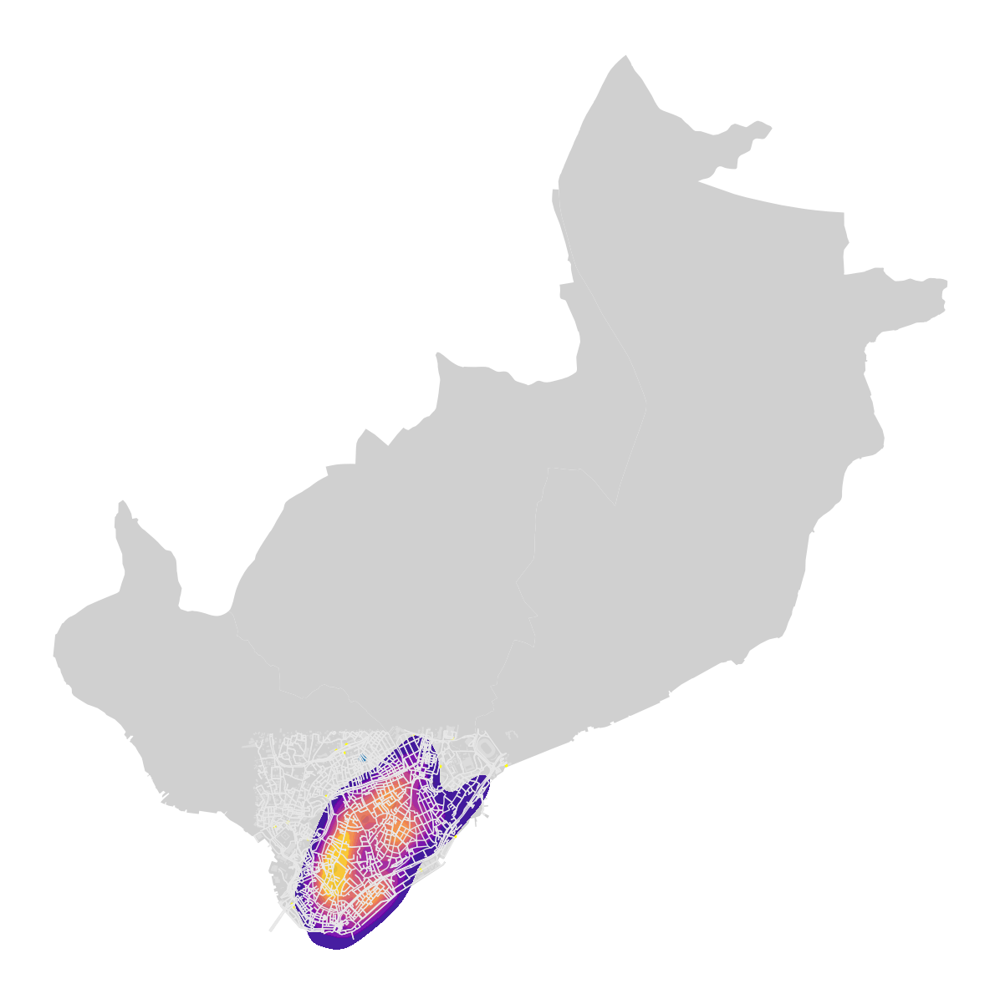

In [ ]:
import seaborn as sns

fig, ax = plt.subplots(figsize=(18,12))

# Plot the footprint
bg_color = "#D0D0D0"
area1.plot(ax=ax, facecolor=bg_color)
area2.plot(ax=ax, facecolor=bg_color)
area3.plot(ax=ax, facecolor=bg_color)

# Plot street edges
edges.plot(ax=ax, linewidth=1, edgecolor='#E8E8E8')

# Plot buildings
buildings.plot(ax=ax, facecolor='#DCDCDC', alpha=1)

# Plot restaurants
restaurants.plot(ax=ax, color='yellow', alpha=1, markersize=3)

levels = [0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
kde = sns.kdeplot(
    ax=ax,
    x=points.x,
    y=points.y,
    levels = levels,
    shade=True,
    cmap='plasma',
    alpha=0.9
)

plt.axis('off')
plt.tight_layout()
plt.savefig("Istanbul.svg")
plt.show()

Export in Figma and cut the areas by clipping content in frame

# Day 28. Is this a chart or a map?

In [ ]:
!pip install -U kaleido

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 6.3 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.


Data source: https://en.wikipedia.org/wiki/List_of_Himalayan_peaks_and_passes#

In [ ]:
import pandas as pd

df = pd.read_excel("Himalaya.xlsx")
df.head()

,Global Rank,Peaks,Other names and meaning,Elevation_m,Elevation_ft,Prominence_m,Isolation,Region,Coordinates,First Ascent,Notes
0,1.0,Mount Everest,"Sagarmatha, Chomolungma",8.848,29.032,8.848,infinite,Mahalangur,27°59′17″N 86°55′31″E,1953,Highest peak in the world[1]
1,2.0,K2,"Godwin Austin, Chhogori ""Savage Mountain""",8.611,28.251,4.020,136,Karakoram,35°52′57″N 76°30′48″E,1954,Second highest peak in the world[3]
2,3.0,Kanchenjunga,"""Five treasures of great snow""",8.586,28.169,3.922,124.3,Nepal/India,27°42′12″N 88°08′51″E,1955,"Third highest peak in the world, Easternmost 8..."
3,4.0,Lhotse,"""South Peak""",8.516,27.940,610.000,2023-07-02 00:00:00,Mahalangur,27°57′42″N 86°55′59″E,1956,Part of Everest massif
4,5.0,Makalu,"""The Great Black""",8.485,27.838,2.378,2023-02-17 00:00:00,Mahalangur,27°53′23″N 87°05′20″E,1955,East of Mt. Everest


In [ ]:
df[['Latitude', 'Longitude']] = df['Coordinates'].str.split(' ', n=1, expand=True)


df['Latitude']  = df['Latitude'].apply(convert)
df['Longitude']  = df['Longitude'].apply(convert)
df.head()

,Global Rank,Peaks,Other names and meaning,Elevation_m,Elevation_ft,Prominence_m,Isolation,Region,Coordinates,First Ascent,Notes,Latitude,Longitude
0,1.0,Mount Everest,"Sagarmatha, Chomolungma",8.848,29.032,8.848,infinite,Mahalangur,27°59′17″N 86°55′31″E,1953,Highest peak in the world[1],27.988056,86.925278
1,2.0,K2,"Godwin Austin, Chhogori ""Savage Mountain""",8.611,28.251,4.020,136,Karakoram,35°52′57″N 76°30′48″E,1954,Second highest peak in the world[3],35.882500,76.513333
2,3.0,Kanchenjunga,"""Five treasures of great snow""",8.586,28.169,3.922,124.3,Nepal/India,27°42′12″N 88°08′51″E,1955,"Third highest peak in the world, Easternmost 8...",27.703333,88.147500
3,4.0,Lhotse,"""South Peak""",8.516,27.940,610.000,2023-07-02 00:00:00,Mahalangur,27°57′42″N 86°55′59″E,1956,Part of Everest massif,27.961667,86.933056
4,5.0,Makalu,"""The Great Black""",8.485,27.838,2.378,2023-02-17 00:00:00,Mahalangur,27°53′23″N 87°05′20″E,1955,East of Mt. Everest,27.889722,87.088889


Scale sizes of bubbles, to make plot more informative

In [ ]:
from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler(feature_range=(1, 50))
df['height_m'] = scaler.fit_transform(df['Elevation_m'].values.reshape(-1,1))
# df.height_m = (df.height_m + 0.1) * 5

Manually found coordinates and cities to plot, was very interesting to find them on map

In [ ]:
cities = pd.DataFrame([["Kathmandu", 27.700769, 85.300140],
                       ["Lukla", 27.6860, 86.7255],
                       ["Pokhara", 28.237987, 83.995588],
                       ["Haldwani", 29.219677, 79.512459],
                       ["Dehradun", 30.316496, 78.032188],
                       ["Srinagar", 34.08442, 74.7991],
                       ["Darjeeling", 27.036007, 88.262672],
                       ["Thimphu", 27.472792, 89.639286],
                       ["Biratnagar", 26.452475, 87.271781],
                       ["Cona County", 27.922662976, 93.456498174],
                       ["Tawang", 27.578366, 91.876341],
                       ["Mechuka", 28.581493, 94.124275],
                       ["Nyingchi", 29.651808, 94.356590],
                       ["Shannan", 29.240574, 91.774055],
                       ["Lhasa", 29.652491, 91.172112],
                       ["Shigatse", 29.266870, 88.880585],
                       ["Pulam Sumda", 31.3064855, 79.1306866],
                       ["Leh", 34.152588, 77.577049]])

In [ ]:
import plotly.express as px

colors = px.colors.qualitative.Plotly * 4
fig = px.scatter(df, x="Longitude", y="Latitude",
	         size="height_m", color="Region",
                 hover_name="Peaks", size_max=50,
                 width=1600, height=800,
                 range_y=[26, 37])

fig.add_scatter(x=cities[2], y=cities[1], marker=dict(color='black'), text=cities[0], mode="markers+text")
fig.update_traces(textposition='bottom left')

fig.update_layout(
    font_family="Ubuntu",
    title_font_family="Ubuntu",
)
fig.update_layout(
    title=dict(text="Himalayan peaks", font=dict(size=30), automargin=True, yref='paper')
)
fig.update_xaxes(title_font_family="Ubuntu")

fig.write_image("day28.svg", format='svg', height=800, width=1600, scale=2)
fig.show()